In [1]:
import numpy as np
import pandas as pd
import tqdm
import re

In [2]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix, bsr_matrix
from scipy.sparse.linalg import svds

In [3]:
books = pd.read_csv("HW/BX-Books.csv")

/Users/ulia/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [5]:
interactions = pd.read_csv("HW/BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [6]:
interactions.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [7]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [8]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [9]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [10]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [11]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [12]:
users = pd.read_csv('HW/BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [13]:
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [14]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [15]:
users['city'] = [loc.split(',')[0] for loc in users['Location'].values]
users['country'] = [loc.split(',')[2][1:] if len(loc.split(',')) > 2 else 'n/a' for loc in users['Location'].values]

In [16]:
interactions = interactions.merge(users[["User-ID", "Age", 'Location', 'city', 'country']], on=["User-ID"])

In [17]:
def fillna():

    interaction_group = interactions[interactions['Age'].isna()]['User-ID'].values

    for i in set(interaction_group):
        tmp = interactions[interactions['User-ID'] == i]['ISBN'].values
        age = interactions[interactions['ISBN'].isin(tmp)].groupby('ISBN').mean()['Age'].values
        if (not np.isnan(age.mean())):
            interactions.loc[interactions[interactions['User-ID'] == i].index.values, 'Age'] = int(age.mean())

    interaction_group = interactions[interactions['Age'].isna()]['Location']
    
    for i in set(interaction_group.values):
        tmp = interactions[interactions['Location'] == i].index.values
        val = interactions.loc[tmp]['Age'].mean()
        if (not np.isnan(val)):
            interactions.loc[set(tmp) & set(interaction_group.index.values), 'Age'] = int(val)
    return interactions[interactions['Age'].isna()].shape[0]

In [18]:
pred = 1
f = 0
while(pred):
    now = fillna()
    pred = f - now
    f = now

interactions['Age'].fillna(value=interactions['Age'].mean(), inplace=True)

In [19]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [20]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [21]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

In [22]:
csr_rates.shape

(10960, 10712)

In [23]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(25, 5))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(measure[cnt]))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

In [24]:
users.groupby('Location').count().sort_values('User-ID', ascending=False)['User-ID'].head(10)

Location
london, england, united kingdom        2506
toronto, ontario, canada               2250
sydney, new south wales, australia     1744
melbourne, victoria, australia         1708
portland, oregon, usa                  1629
chicago, illinois, usa                 1526
seattle, washington, usa               1484
new york, new york, usa                1411
madrid, madrid, spain                  1400
vancouver, british columbia, canada    1359
Name: User-ID, dtype: int64

## 1. Personal Top

In [25]:
class Top():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_rec(self, sim_people, top=10):
        self.interactions['weight'] = self.interactions['Book-Rating'] 
        tmp_df = self.interactions[self.interactions['User-ID'].isin(sim_people)].groupby('product_id').mean().sort_values('weight' , ascending=False)['Book-Rating']
        tmp_df = tmp_df.to_frame().merge(self.interactions[['product_id', 'ISBN']], on='product_id').drop_duplicates()
        rec_imaging(tmp_df['product_id'][0:top].values, self.product_id_to_url, tmp_df['ISBN'][0:top].values)
        
        
    def personal_top(self, age, country=None, city=None, top=10):
        if age < 20:
            t = 2
        elif age < 35: 
            t = 5
        else:
            t = 20
        sim_people = set(self.interactions['User-ID'].values)
        if age != None:
            sim_people &= set(self.interactions[self.interactions['Age'].between(age - 2, age + 2)]['User-ID'].values)
        if city != None:
            sim_people &= set(self.interactions[self.interactions['country'] == country]['User-ID'].values)
        if city != None:
            sim_people &= set(self.interactions[self.interactions['city'] == city]['User-ID'].values)
        self.top_rec(sim_people)
        

In [26]:
T = Top(interactions)

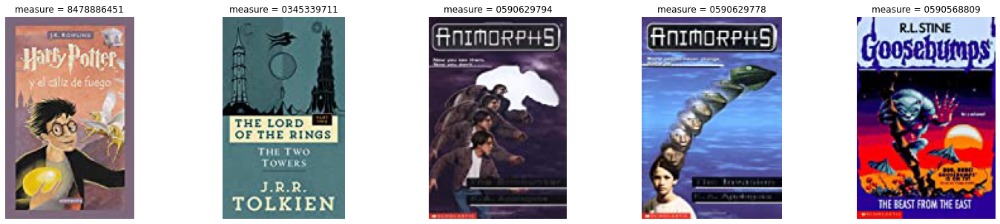

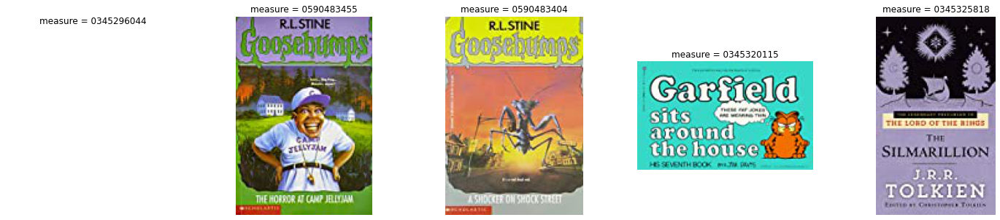

In [27]:
T.personal_top(13)

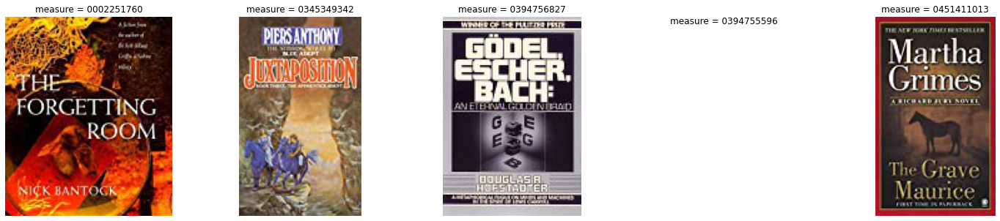

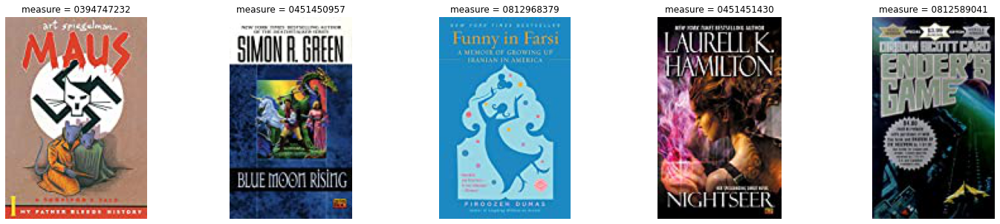

In [28]:
T.personal_top(22)

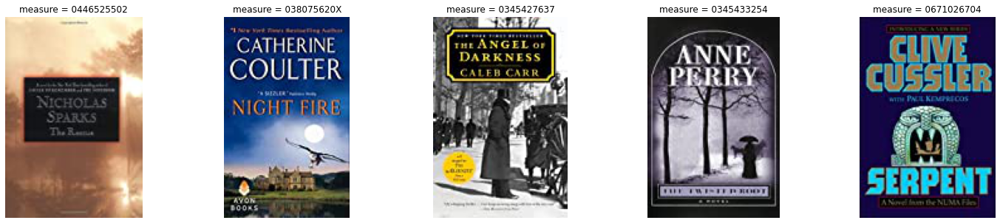

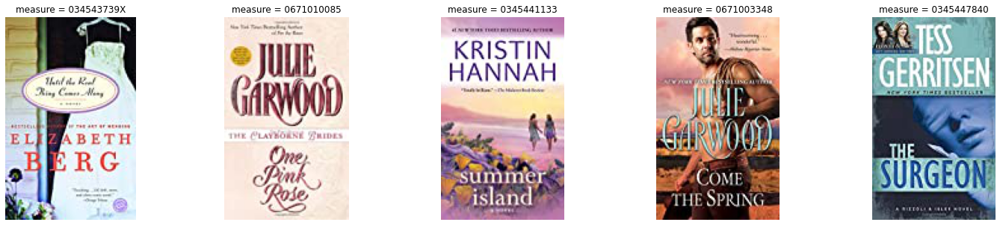

In [29]:
T.personal_top(55)

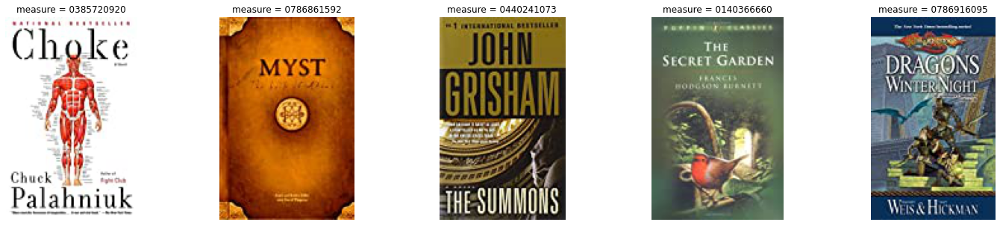

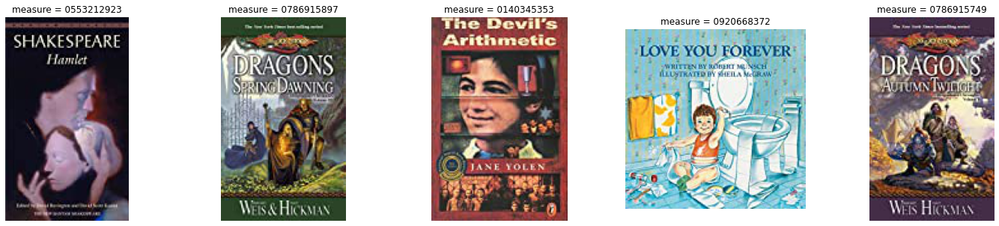

In [30]:
T.personal_top(16, 'usa')

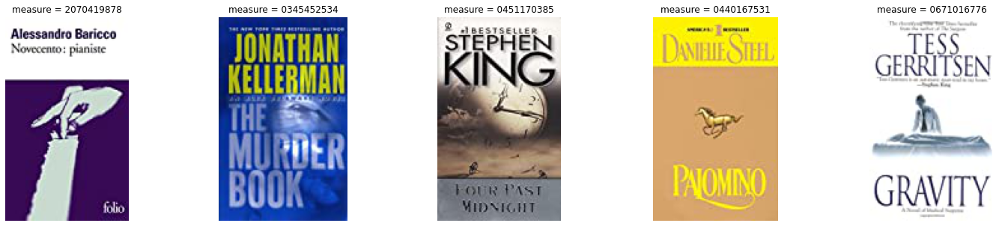

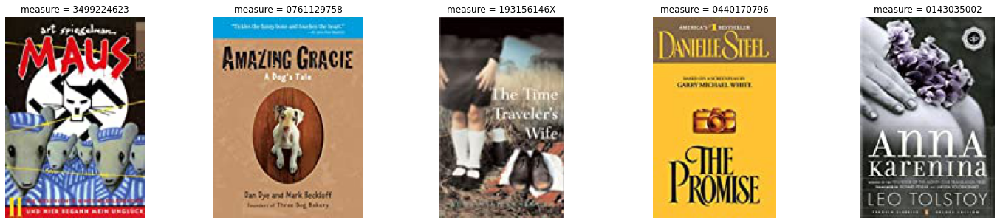

In [31]:
T.personal_top(45, 'england')

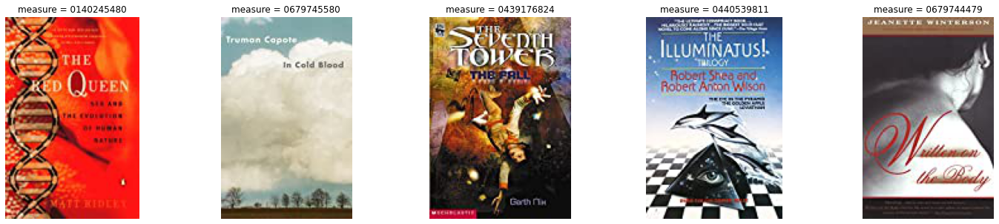

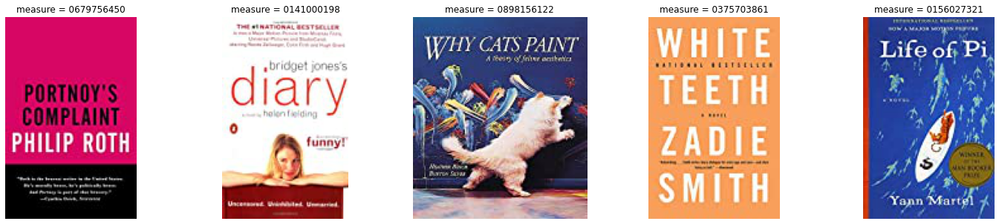

In [32]:
T.personal_top(30, 'australia', 'sydney')

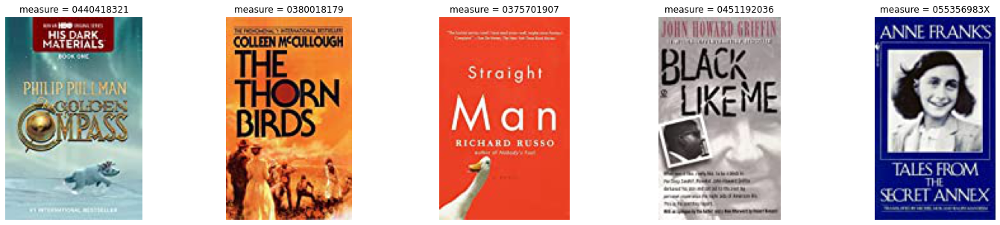

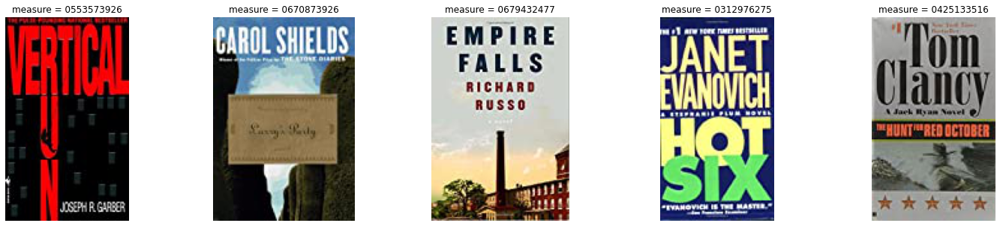

In [33]:
T.personal_top(50, 'canada', 'toronto')

## 2. Кластеризация 

In [34]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN(eps=1, min_samples=3).fit(csr_rates.toarray())

In [35]:
len(set(clustering.labels_))

12

In [36]:
from tqdm import tqdm 

for i in tqdm(range(len(interactions['vid'].unique()))):
    interactions.loc[interactions['vid'] == interactions['vid'].unique()[i], 'labels'] = clustering.labels_[i]

100%|██████████| 10960/10960 [00:28<00:00, 381.63it/s]


In [37]:
product_id_to_url = {}
for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

Label  0


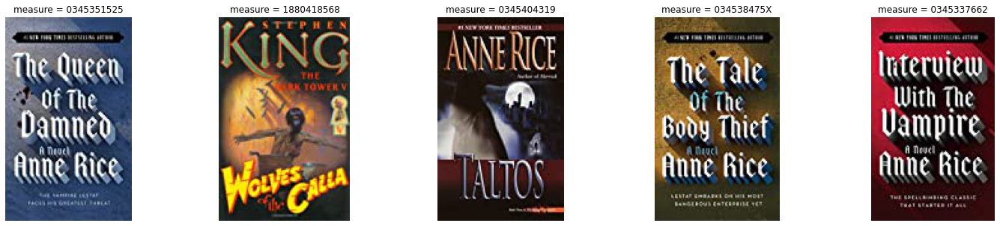

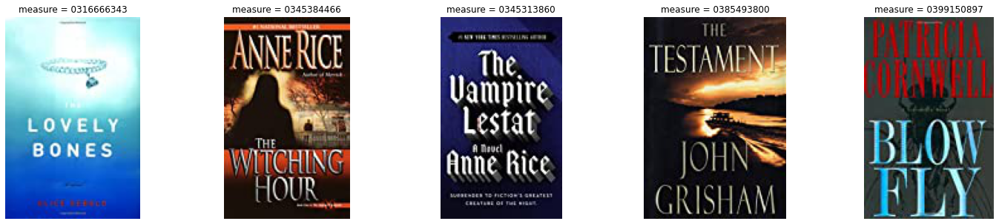

Label  1


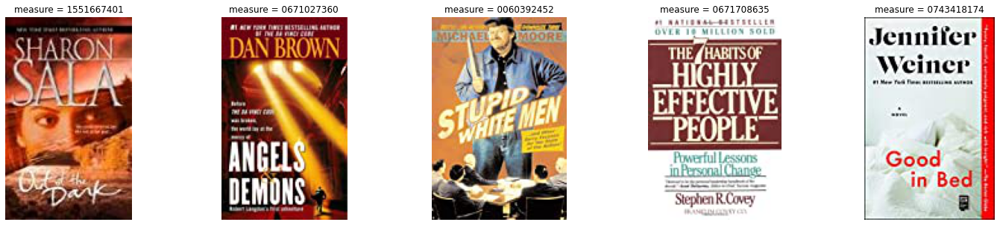

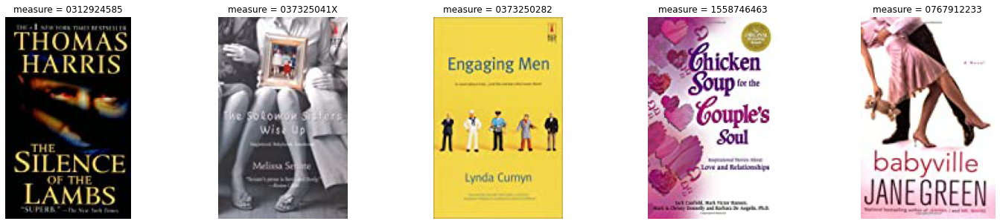

Label  2


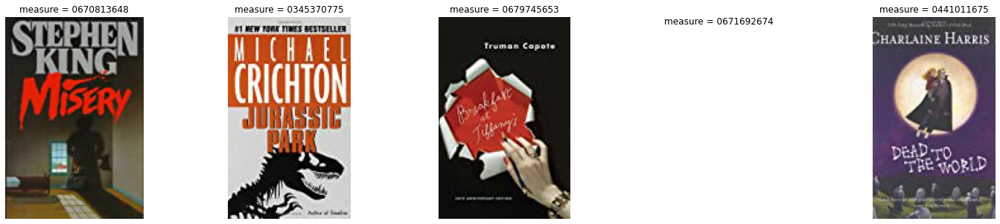

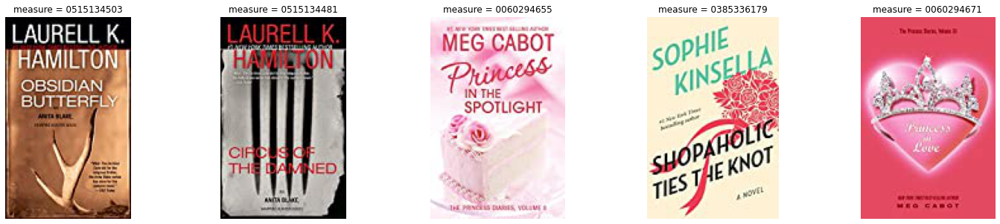

Label  3


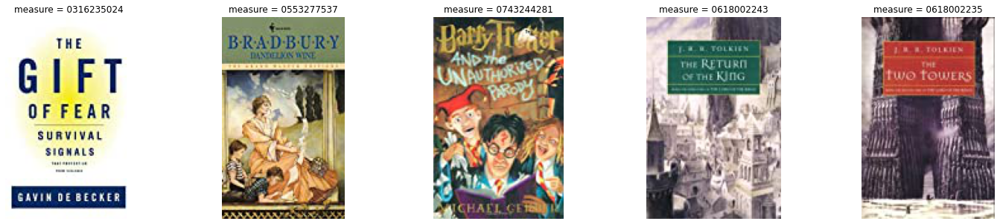

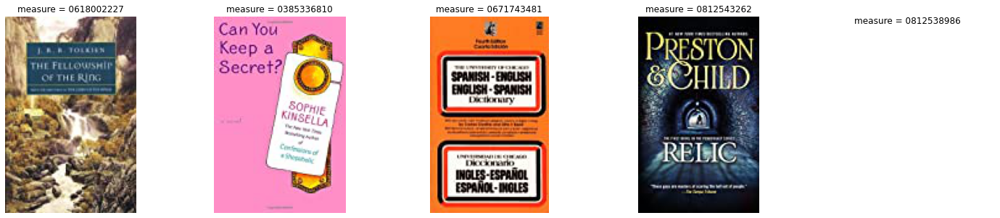

Label  4


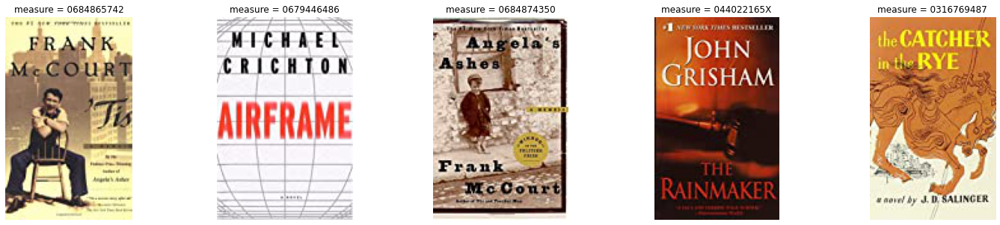

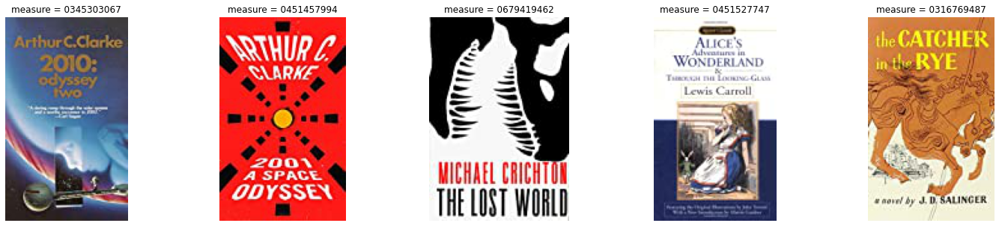

Label  5


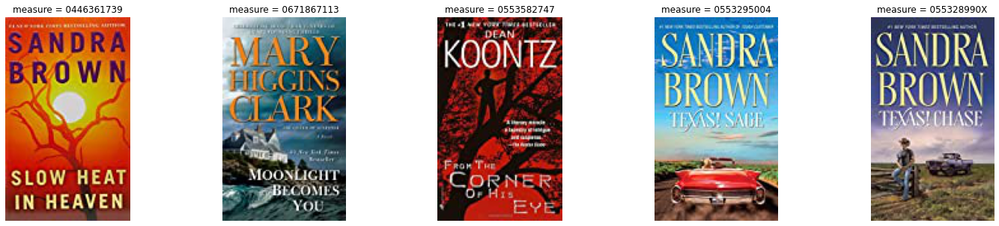

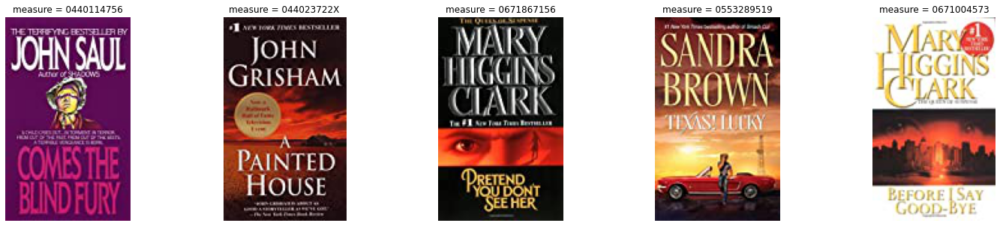

Label  6


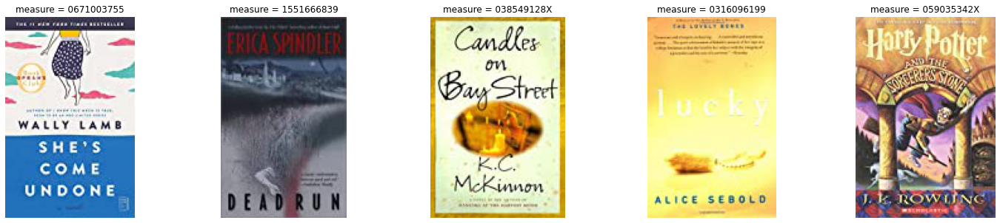

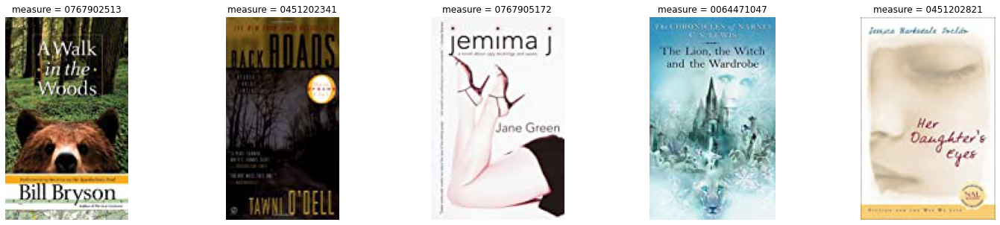

Label  7


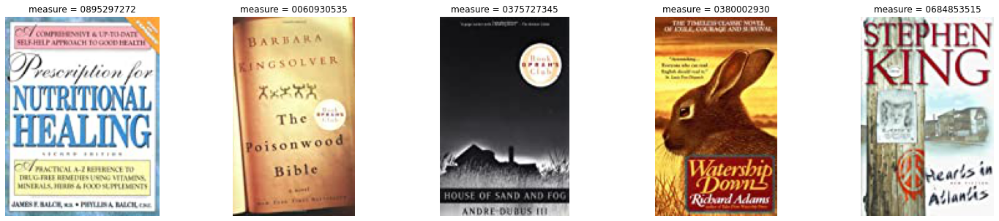

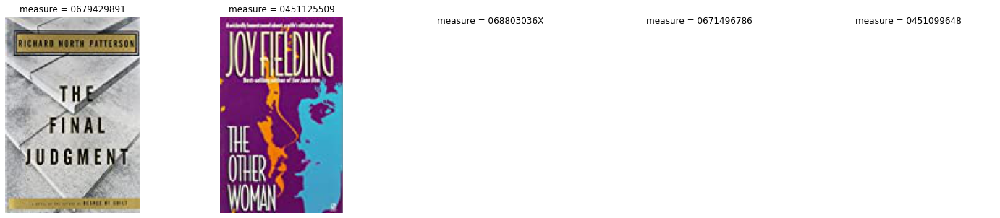

Label  8


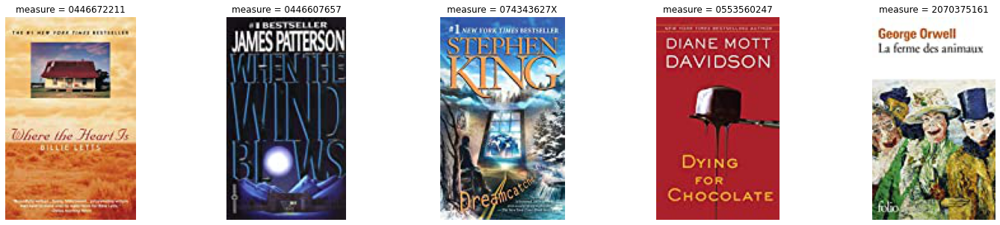

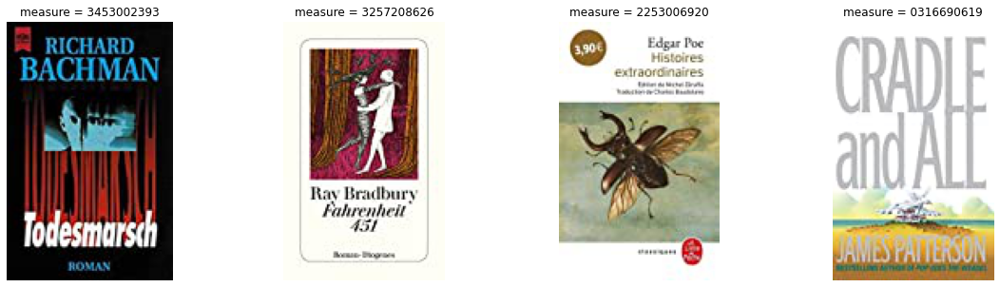

Label  9


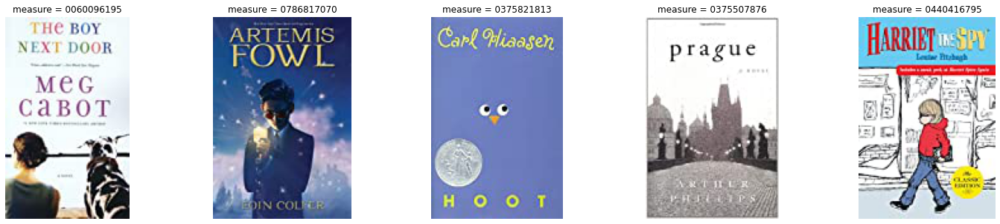

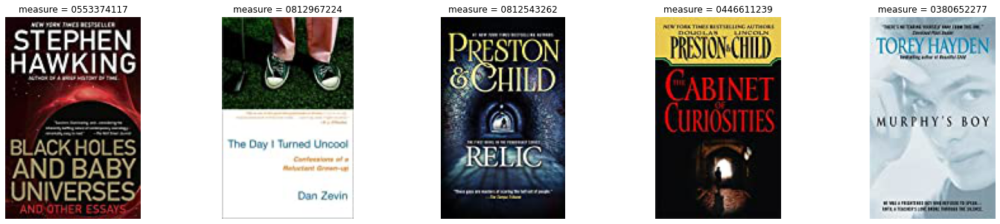

Label  10


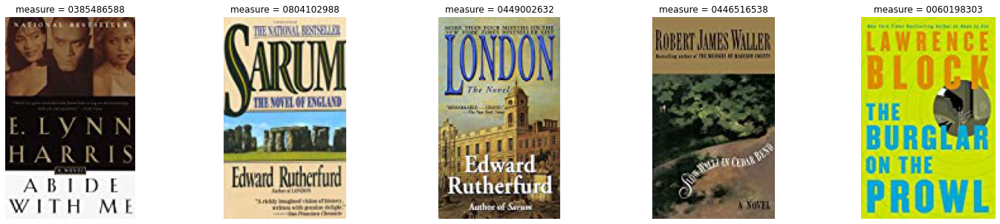

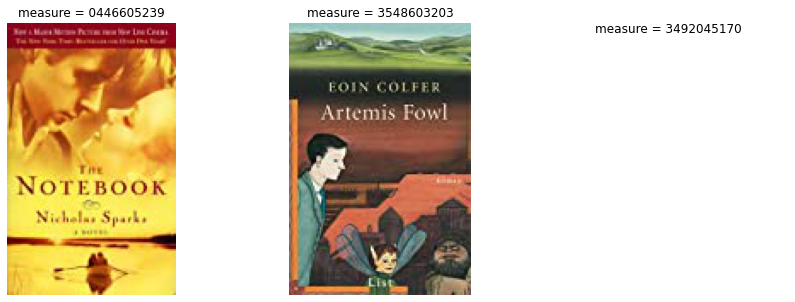

Label  -1


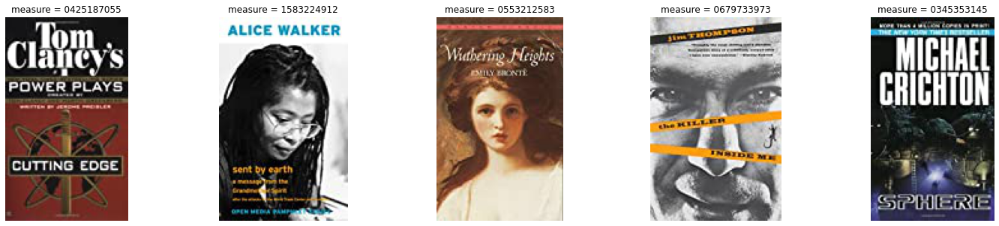

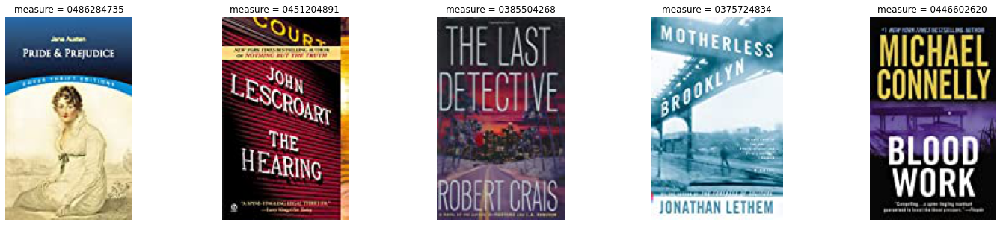

In [38]:
for i in set(clustering.labels_):
    print("Label ", i)
    tmp = interactions[interactions['labels'] == i].sort_values('Book-Rating', ascending=False)
    rec_imaging(tmp['product_id'][0:10].values, product_id_to_url, tmp['ISBN'][0:10].values)

## 3. Other Methods

### 3.1 Совстречаемость 

In [39]:
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = interactions[["vid", "product_id", 'Book-Rating']].drop_duplicates()
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        user_products = user_products[user_products["prod_num"] > 1]
        Int = Int.set_index(["vid", "product_id"])
        cooc = {}
        for i in tqdm(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        rate = (Int.loc[(i[0], i[1][j]), 'Book-Rating'] + Int.loc[(i[0], i[1][k]), 'Book-Rating']) / 2
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += rate
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = rate
        cooc_list = []
        for i, j in cooc.items():
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для книги")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [40]:
cooc_rec = Recomendations(interactions)
cooc_rec.coocurrency_count()

100%|██████████| 10012/10012 [21:59<00:00,  7.59it/s] 


Для книги


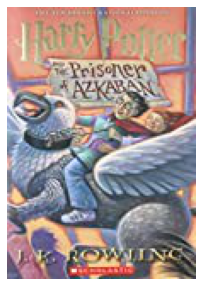

Такие рекомендации


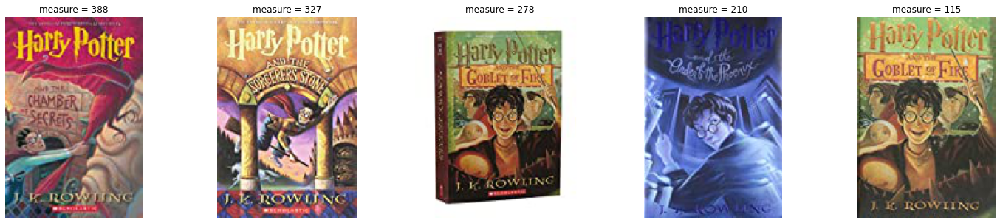

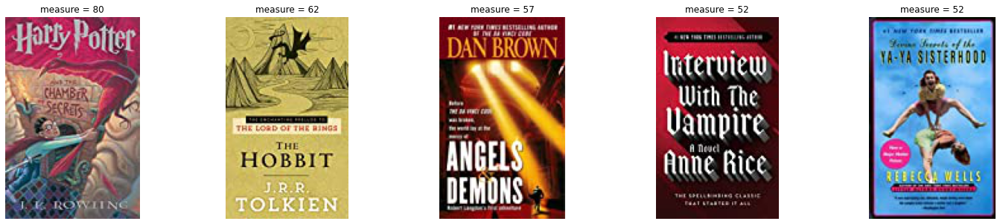

In [41]:
cooc_rec.get_rec(4225)

Для книги


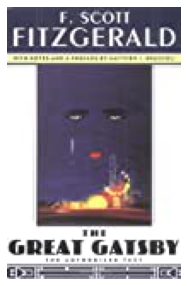

Такие рекомендации


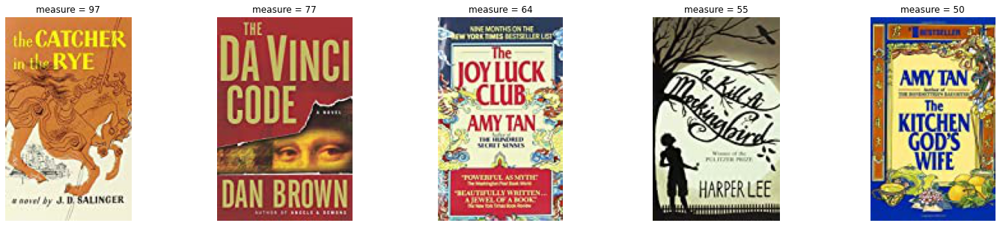

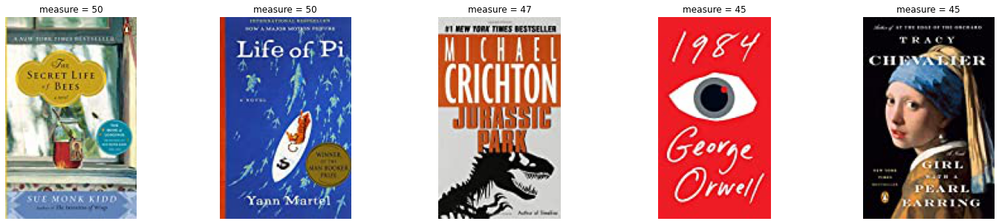

In [42]:
cooc_rec.get_rec(8177)

Для книги


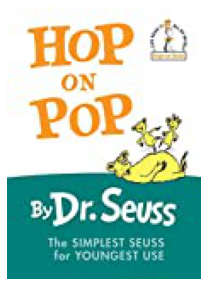

Такие рекомендации


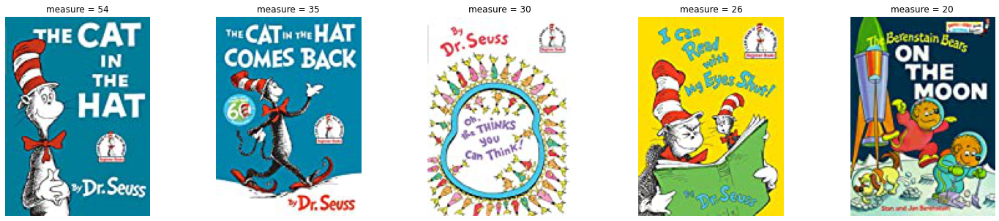

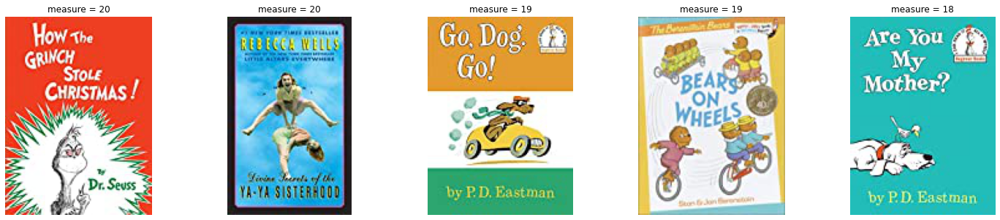

In [43]:
cooc_rec.get_rec(3594)

Для книги


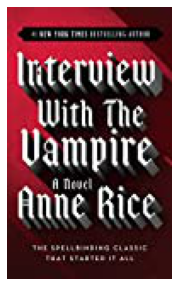

Такие рекомендации


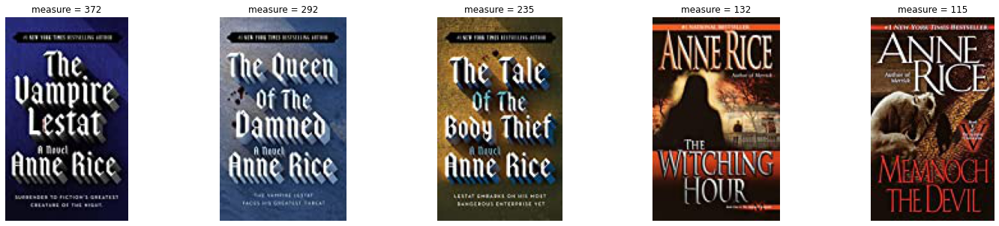

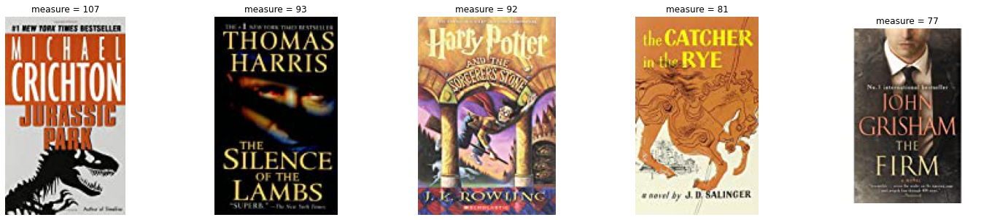

In [44]:
cooc_rec.get_rec(1916)

### 3.2 Content-based

In [45]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions
        self.content_dict = {}
        for i, j in enumerate(items["Image-URL-M"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['Book-Title']]
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["Book-Title"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [46]:
cb = Content_Based(books, interactions)

In [47]:
cb.get_items_representation()

Для товара


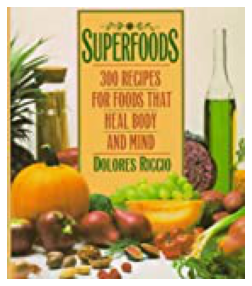

Такие рекомендации


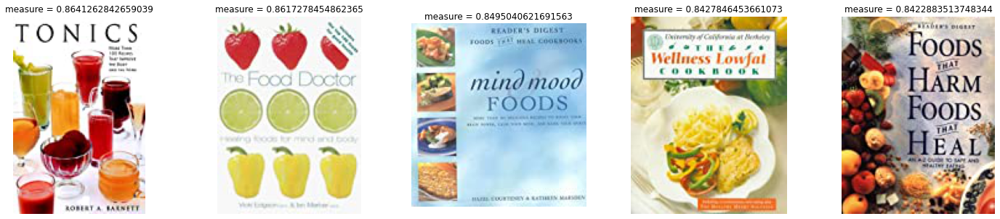

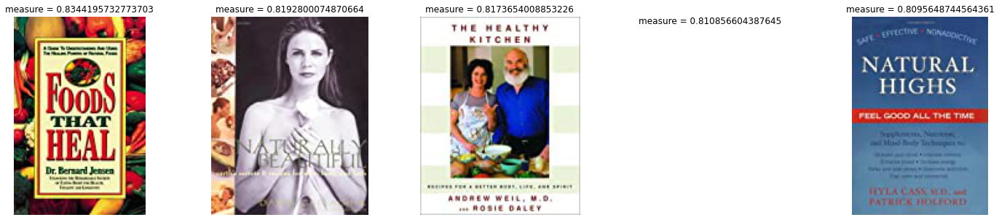

In [48]:
cb.get_rec_I2I(41529)

Для товара


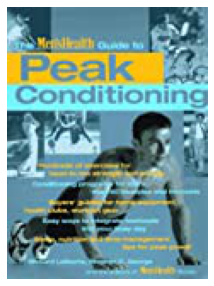

Такие рекомендации


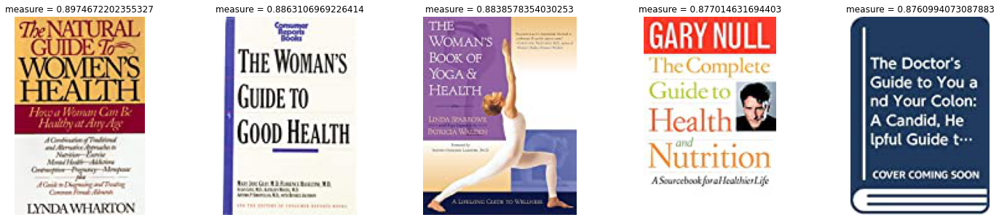

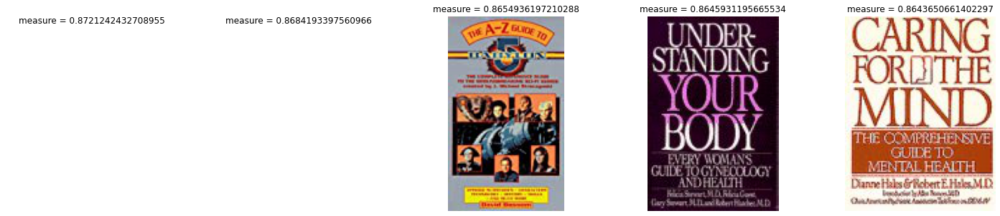

In [49]:
cb.get_rec_I2I(7111)

Для товара


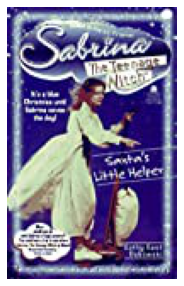

Такие рекомендации


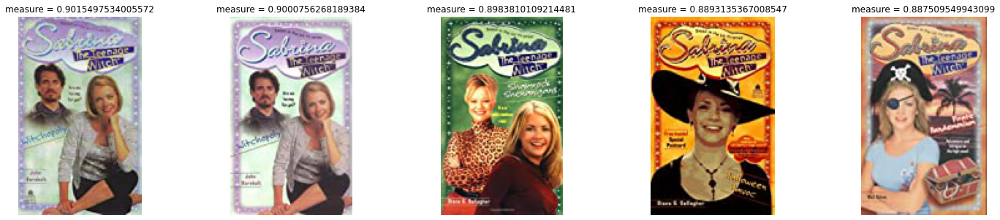

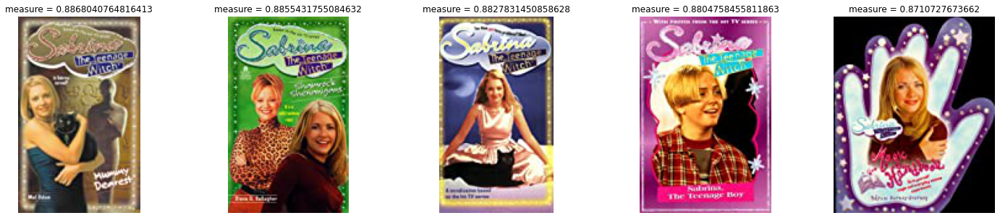

In [50]:
cb.get_rec_I2I(3401)

Для товара


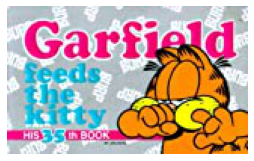

Такие рекомендации


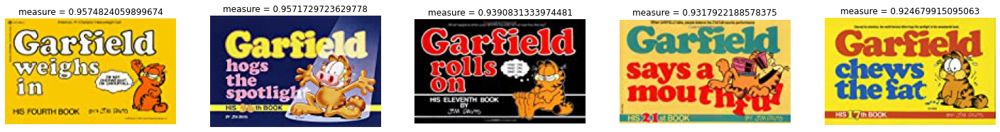

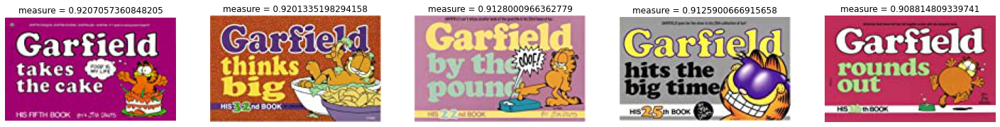

In [51]:
cb.get_rec_I2I(12345)

Для пользователя, который взаимодействовал с товарами


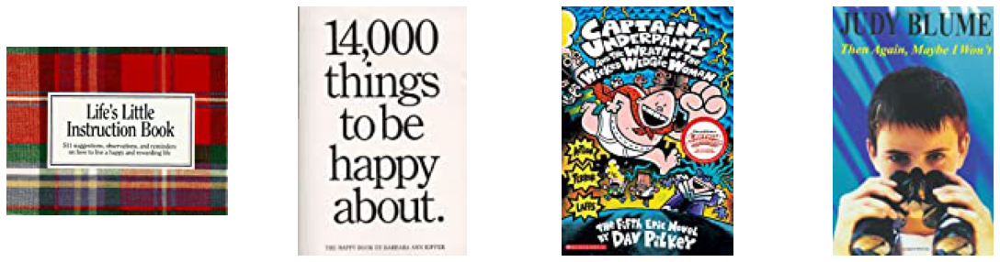

Такие рекомендации


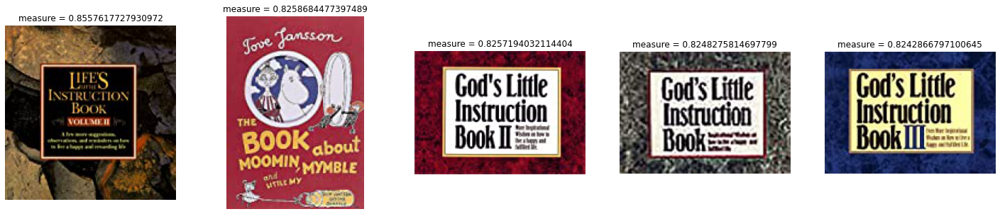

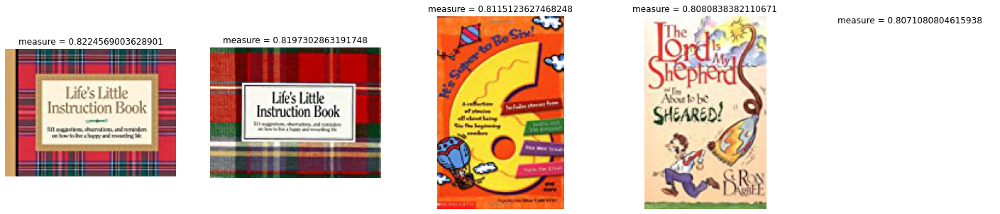

In [52]:
cb.get_rec_U2I(10958)

Для пользователя, который взаимодействовал с товарами


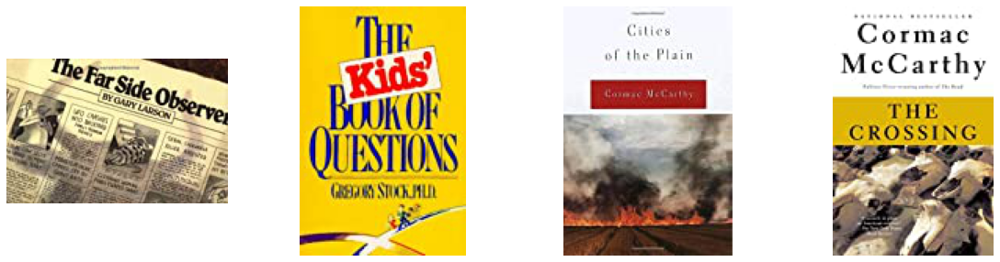

Такие рекомендации


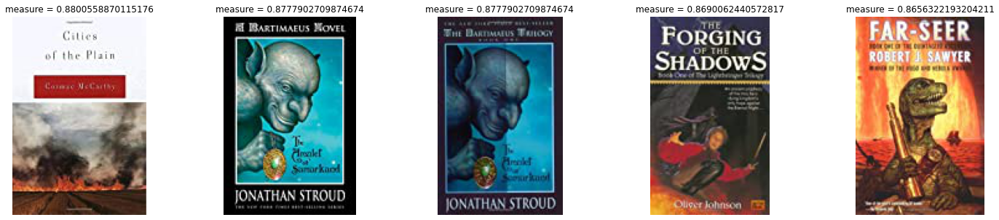

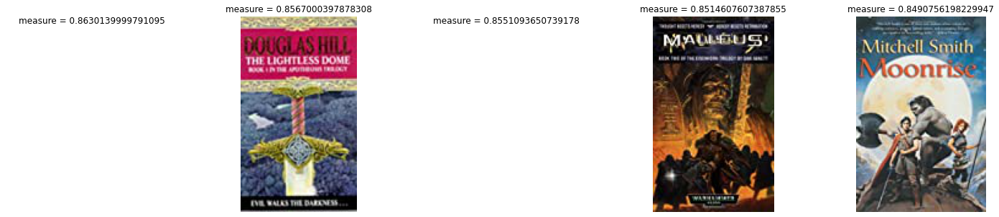

In [53]:
cb.get_rec_U2I(7164)

### 3.3 Colloborative filtering

In [54]:
interactions["weight"] = (interactions["Book-Rating"] > 0).astype(int)

In [55]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        interactions["weight"] = (interactions["Book-Rating"] >= 5).astype(int)
        self.csr_rates = coo_matrix((interactions["weight"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))
        

    def user_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [56]:
clb = Colloborative(interactions)

Для таких товаров


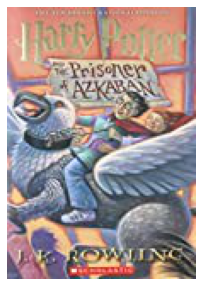

Такие рекомендации


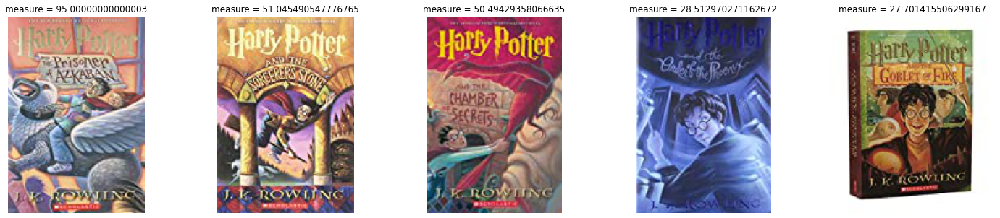

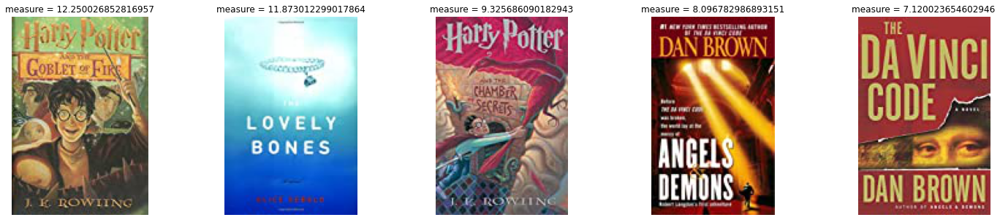

In [57]:
clb.item_based(4225)

Для таких товаров


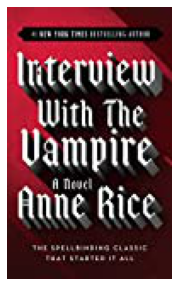

Такие рекомендации


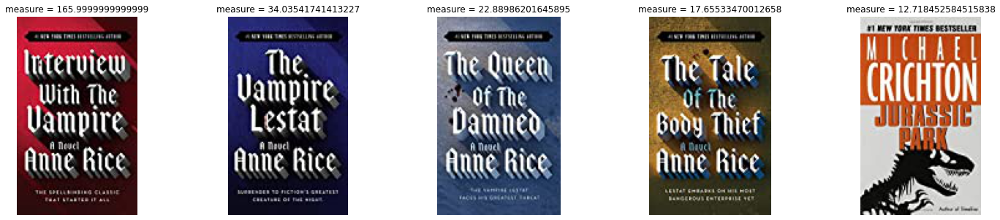

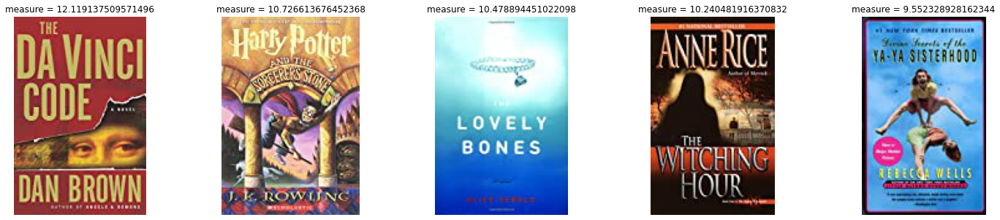

In [58]:
clb.item_based(1916)

Для таких товаров


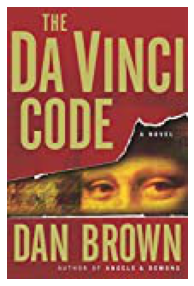

Такие рекомендации


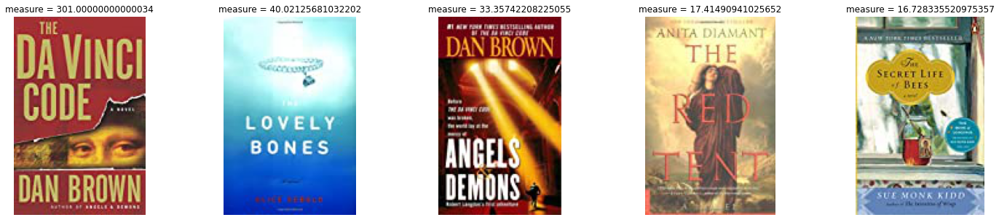

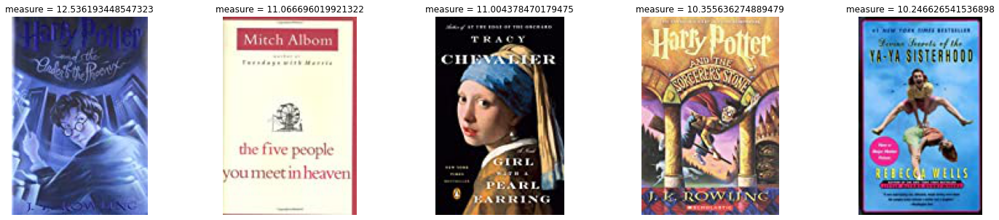

In [59]:
clb.item_based(3461)

Для таких товаров


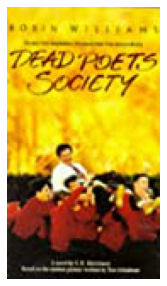

Такие рекомендации


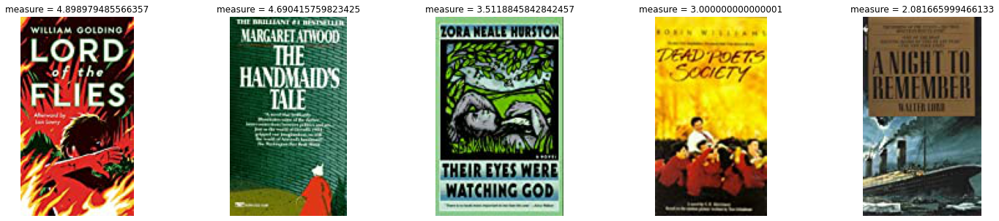

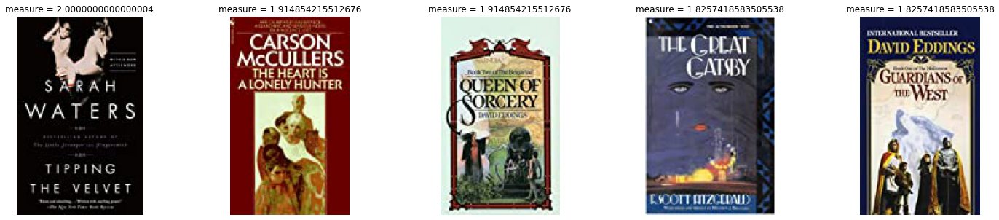

In [60]:
clb.item_based(6559)

Для таких товаров


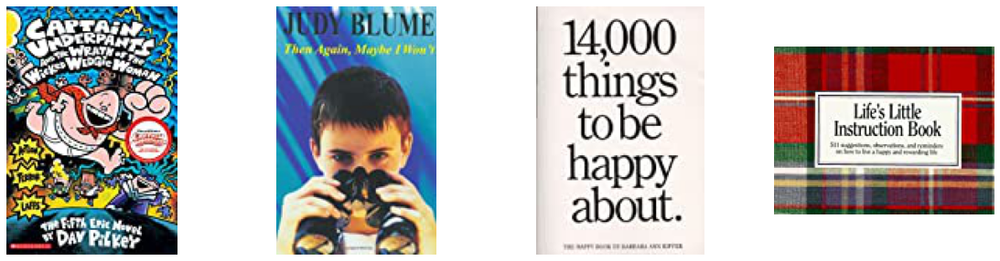

Такие рекомендации


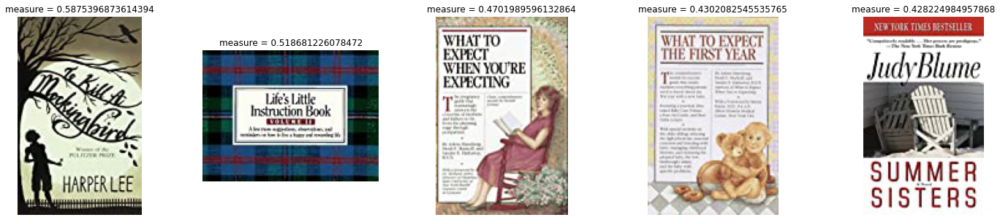

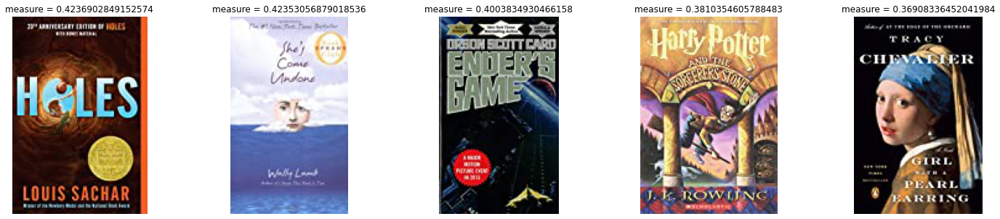

In [61]:
clb.user_based(10958)

Для таких товаров


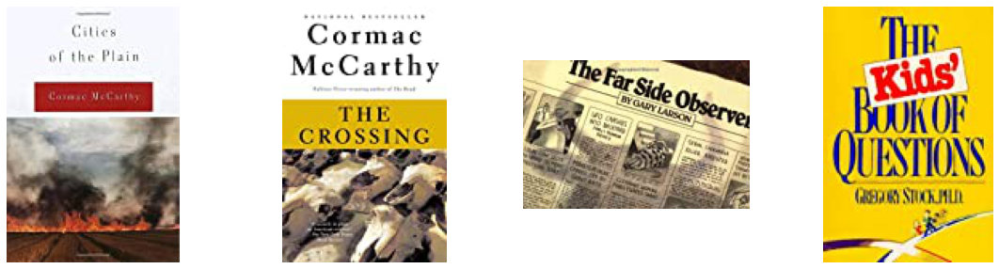

Такие рекомендации


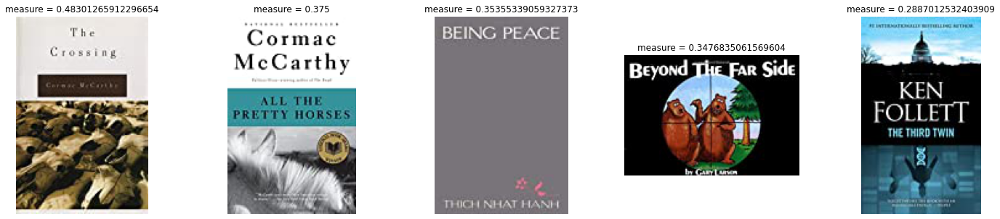

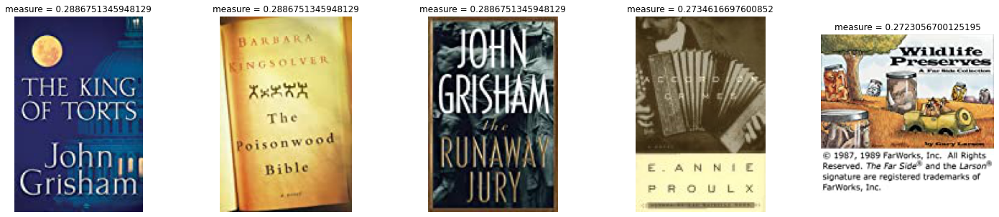

In [62]:
clb.user_based(7164)

### 3.4 Matrix Factorization

In [63]:
from lightfm import LightFM

class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        self.csr_rates = csr_rates
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

/Users/ulia/opt/anaconda3/lib/python3.8/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn('LightFM was compiled without OpenMP support. '


In [64]:
simple_svd = MatrixFactorization(interactions, 30)
simple_svd.MF()

Для товара


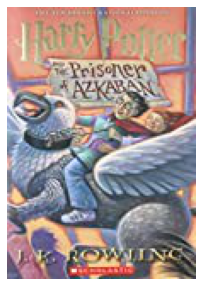

Такие рекомендации


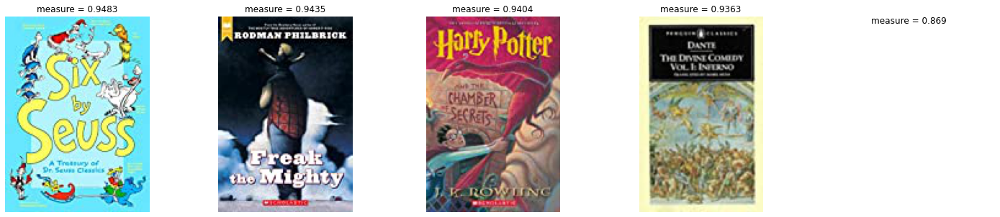

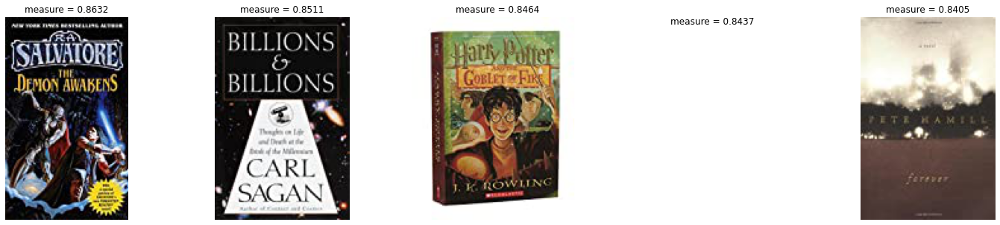

In [65]:
simple_svd.get_rec(4225)

Для товара


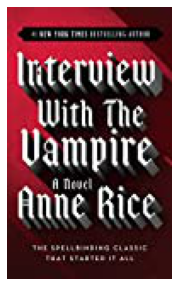

Такие рекомендации


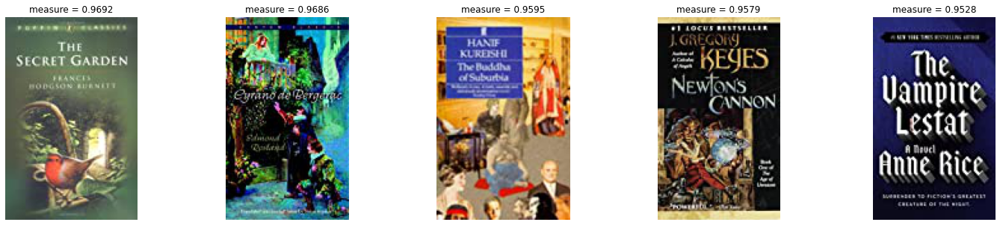

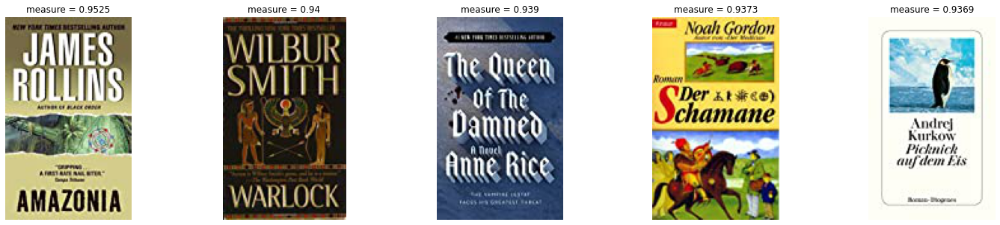

In [66]:
simple_svd.get_rec(1916)

Для товара


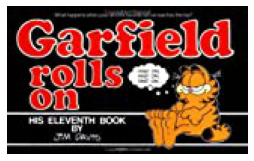

Такие рекомендации


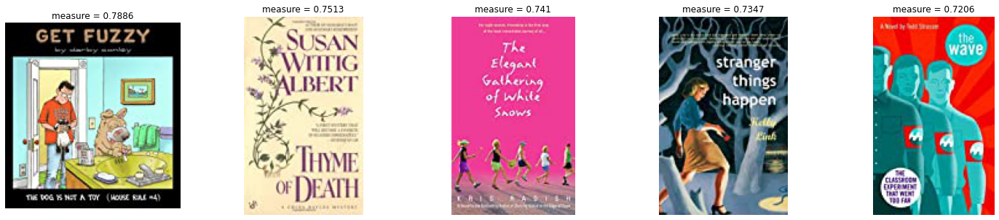

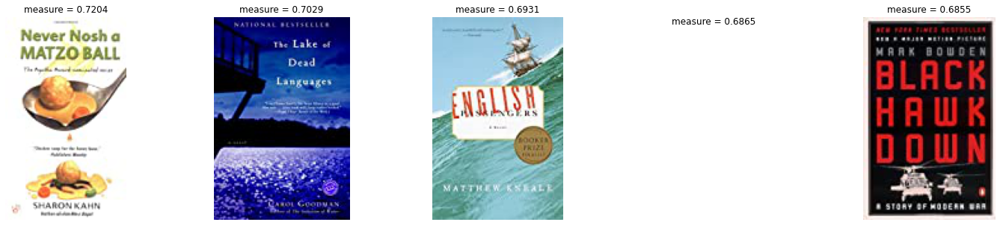

In [70]:
simple_svd.get_rec(1884)

In [69]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "Garfield" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 1884 	Book Title: Garfield Rolls on (Garfield (Numbered Paperback))
idx: 1964 	Book Title: Garfield Rounds Out (Garfield (Numbered Paperback))
idx: 1873 	Book Title: Garfield Sits Around the House (Garfield (Numbered Paperback))
